# NeurIPS 2021 Submission 4400
# A Normative and Biologically Plausible Algorithm for Independent Component Analysis
## Fig.2 Panel C. 
### Notebook for visualizing the ICA task on image separation task

In [71]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.stats import norm, kurtosis
from scipy import signal
from scipy.io import wavfile
import scipy
import time
from PIL import Image
from sklearn.decomposition import FastICA, PCA

from mpl_toolkits.axes_grid1.inset_locator import zoomed_inset_axes,mark_inset
from mpl_toolkits.axes_grid1 import make_axes_locatable

from FOBI import FOBI
import utilities as utl
import pylab as pl
import string


def random_nonsingular_matrix(d=4):
    """
    Generates a random nonsingular (invertible) matrix if shape d*d
    """
    epsilon = 0.1
    A = np.random.rand(d, d)
    while abs(np.linalg.det(A)) < epsilon:
        A = np.random.rand(d, d)
    return A



## We show below the 13 images of the dataset. 
## The are freely available at https://research.ics.aalto.fi/ica/data/images/ (Accessed May 24th 2021).}


The images considered are of size 256 * 512  pixels


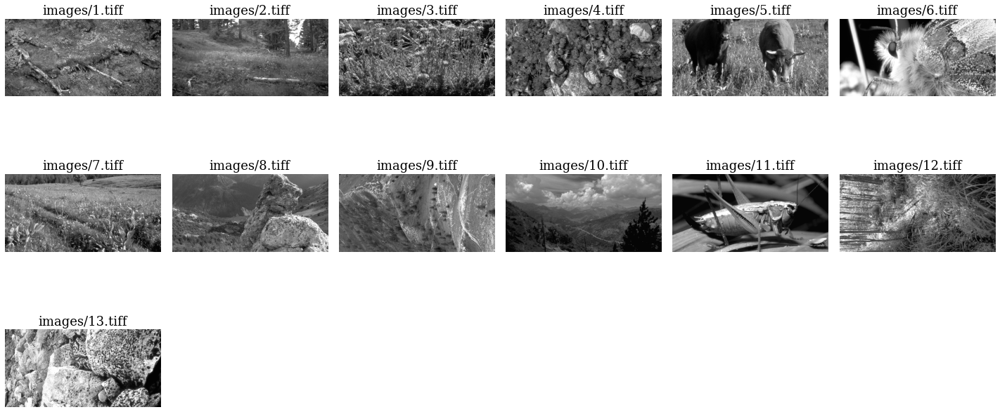

In [74]:
im = Image.open('images/1.tiff')
im_array= np.array(im)

print('The images considered are of size', im_array.shape[0],'*',im_array.shape[1],' pixels')
im_reshaped= np.reshape(im_array,im_array.shape[0]*im_array.shape[1])
im_full_array=np.zeros([13,len(im_reshaped)])

figure = plt.figure(figsize=(20,10))

font = {'family' : 'serif',
        'weight' : 'bold',
        'size'   :  15}

plt.rc('font',**font)#, family='serif'

for iter in range(13):
    name_img='images/'+str(iter+1)+'.tiff'

    im = Image.open(name_img)
    im_array= np.array(im)
    if im_array.shape[0]==512:
        im_array=im_array.T
    im_full_array[iter,:]= np.reshape(im_array,im_array.shape[0]*im_array.shape[1])

    plt.subplot(3,6,iter+1)
    plt.imshow(im_array, cmap="gray")
    plt.title(name_img)
    plt.axis('off')

figure.tight_layout()
plt.show()

In [80]:
#From the dataset we pick three images, with skewed distributions and distinct kurtosis.

Rg_im=[4,6,7]
im_full_array.shape
S= im_full_array[Rg_im]
S.shape
S=S.T
s_dim = S.shape[1]
samples = S.shape[0]

print('We have picked',s_dim,' sources of sample size ', samples)


We have picked 3  sources of sample size  131072


In [57]:
# centering and normalization as mentioned in the paper

S= S - np.mean(S,axis=0)
S /= S.std(axis=0)  # Standardize data
#print(np.mean(S,axis=0)) print(S.std(axis=0)) 
print('The kurtosis of each source is', kurtosis(S, fisher=False))

The kurtosis of each source is [2.47366935 3.05960463 6.63395651]


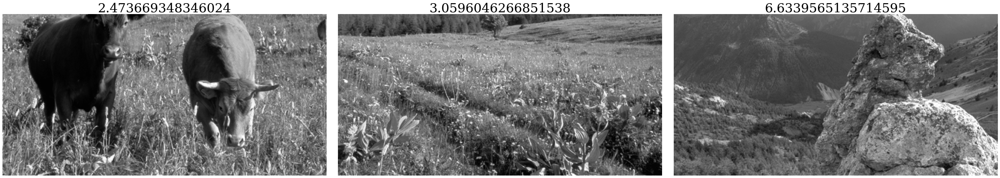

In [81]:
# We plot the images post centering and normalize with their kurtosis on the title
figure = plt.figure(figsize=(40,20))

for i in range(s_dim):
    plt.subplot(1,3,i+1)
    #plt.imshow(S[i].reshape(252,252), cmap="gray")
    plt.imshow(S.T[i].reshape(256,512), cmap="gray")
    plt.title(str(kurtosis(S.T[i],fisher=False)))
    plt.axis('off')

figure.tight_layout()
plt.show()

In [12]:
# Generate mixing matrix and the mixed stimuli
A = random_nonsingular_matrix(d=S.shape[1]) # Mixing matrix
X = np.dot(A,S.T)  # Generate observations

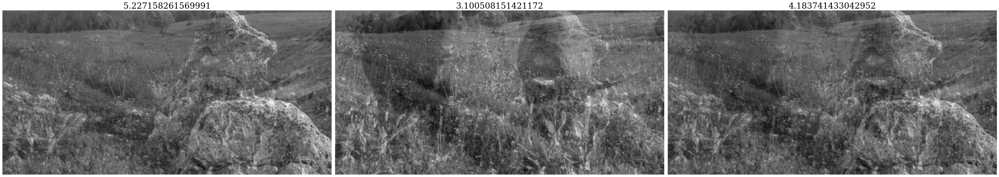

In [75]:
# plot of the mixtures

figure = plt.figure(figsize=(40,20))

font = {'family' : 'serif',
        'weight' : 'bold',
        'size'   :  20}

plt.rc('font',**font)#, family='serif'

for i in range(X.shape[0]):
    plt.subplot(1,3,i+1)
    plt.imshow(X[i].reshape(256,512), cmap="gray")
    plt.title(str(kurtosis(X[i],fisher=False)))
    plt.axis('off')

figure.tight_layout(pad=0.5)
plt.show()

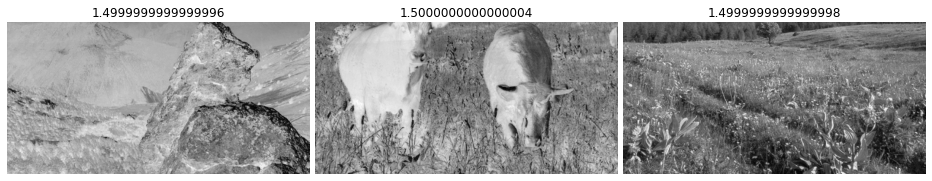

In [24]:
# Example of a solution obtained by FastICA using Sklearn

ica = FastICA(n_components=S.shape[1],whiten=True)
S_ = ica.fit_transform(X.T)  # Reconstruct signals
A_ = ica.mixing_  # Get estimated mixing matrix

figure = plt.figure(figsize=(30,10))
for i in range(S_.T.shape[0]):
    plt.subplot(2,7,i+1)
#    plt.imshow(X[i].reshape(252,252), cmap="gray")
    plt.imshow(S_.T[i].reshape(256,512), cmap="gray")
    plt.title(str(kurtosis(S_[i],fisher=False)))
    plt.axis('off')

figure.tight_layout(pad=0.5)
plt.show()


In [25]:
# Computation "nonlinear covariance matrix"
#Cov_X_bis=(1/num_samples_test)*X_SM@np.diag(np.diag(X_SM.T@(np.linalg.inv(np.cov(X_SM))@X_SM)))@X_SM.T

X.shape
Xcov = (X@X.T) 
print(Xcov.shape)
d,V = np.linalg.eig(Xcov) 
print(d)
D = np.diag(1./np.sqrt(d+0.0)) 
W = V@D@V.T
Xwhiten = (X.T@W.T).T

nonlin_Z = (1+np.sqrt(sum(Xwhiten*Xwhiten)))*Xwhiten
#matrix= X_SM

(3, 3)
[378709.06492184  37252.67557622   1504.26811053]


1 0.022389888763427734


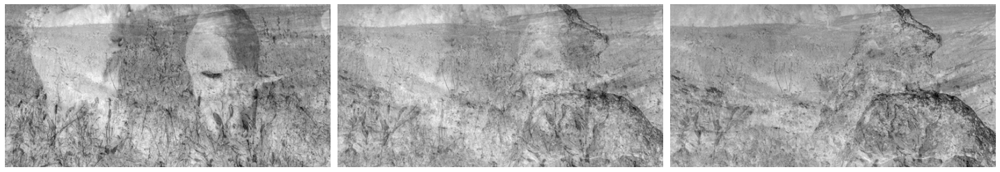

5001 20.373723030090332


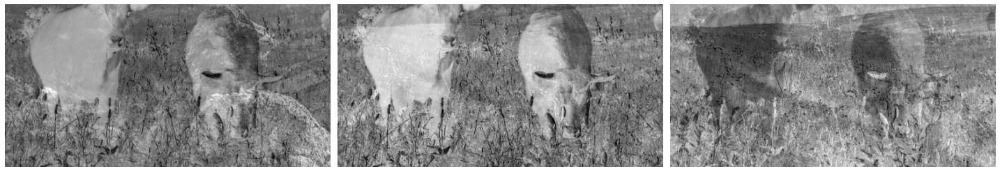

10001 39.44195914268494


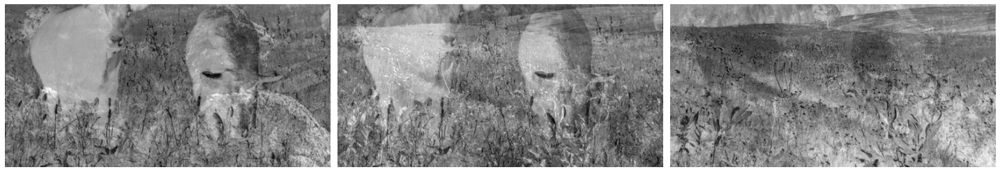

15001 59.93000102043152


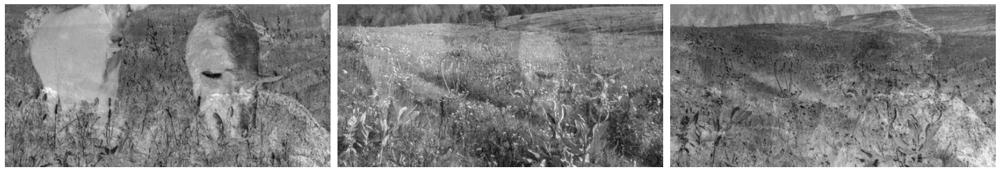

20001 79.41460013389587


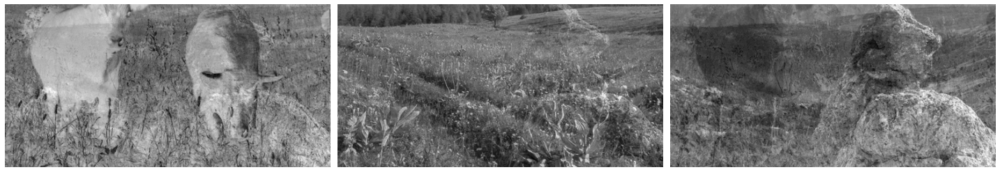

25001 98.1098039150238


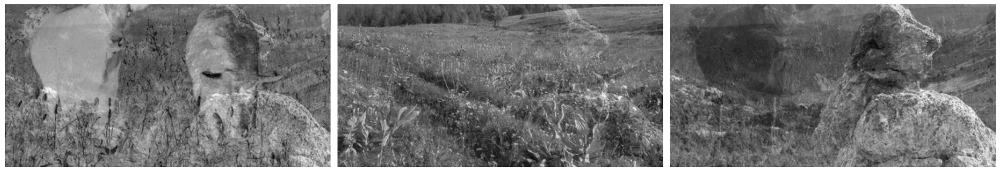

30001 117.0540919303894


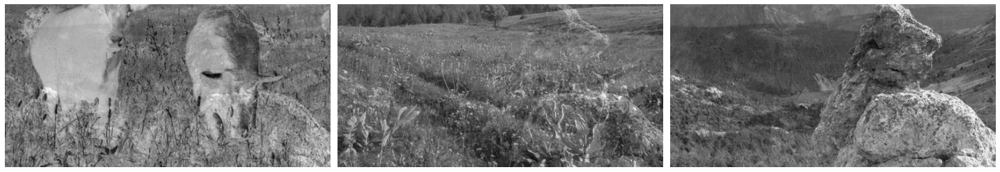

35001 135.4805862903595


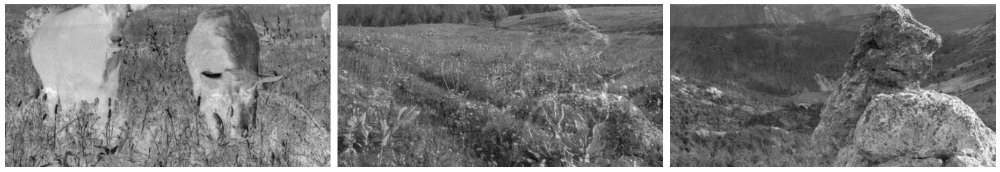

40001 156.61229515075684


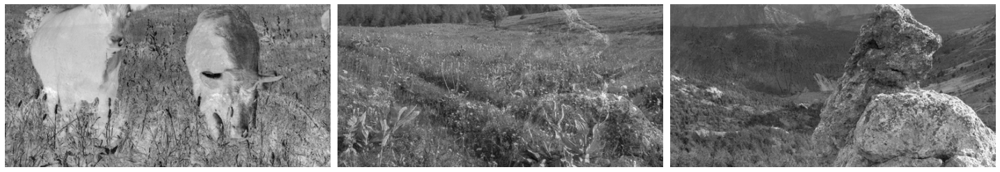

45001 177.80877709388733


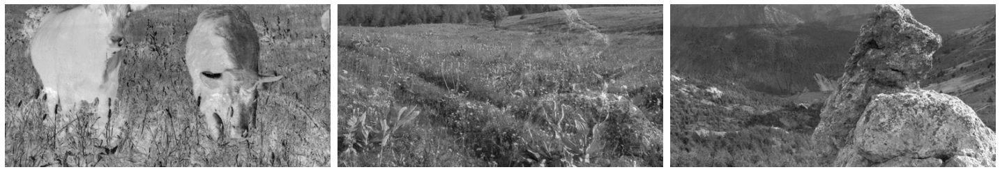

50001 198.32714009284973


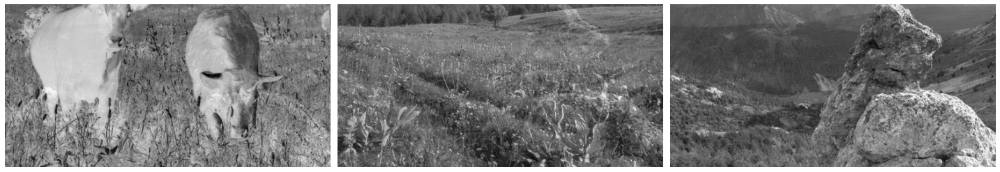

55001 218.62410616874695


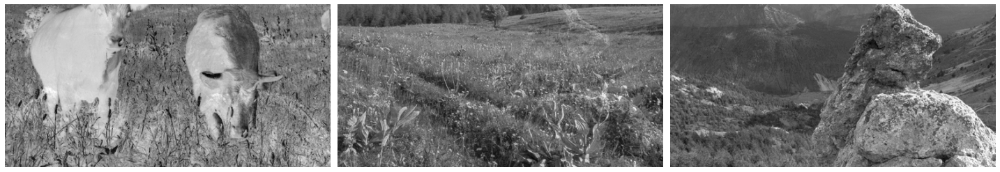

60001 238.75947999954224


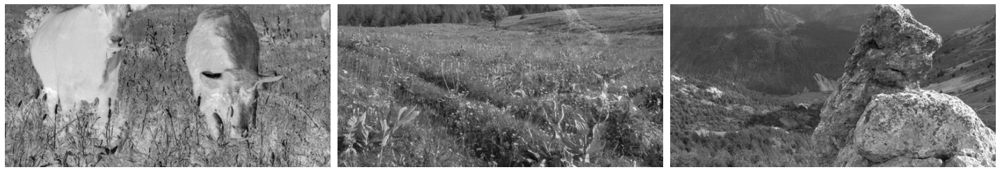

65001 260.0375771522522


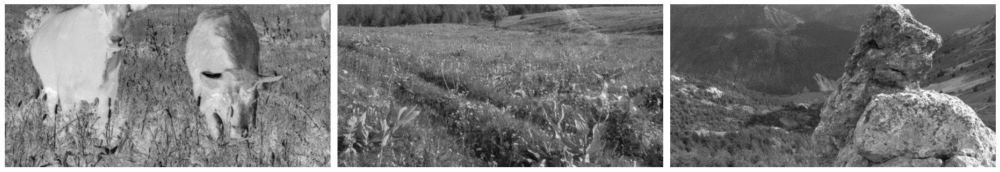

70001 280.9172489643097


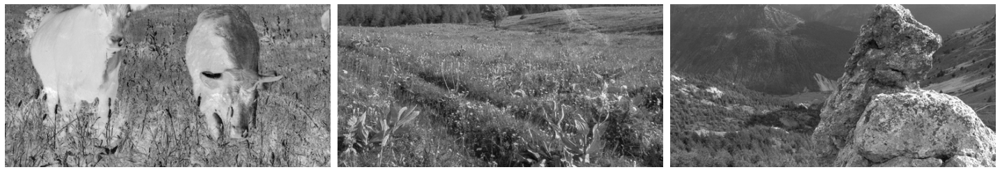

75001 301.33436608314514


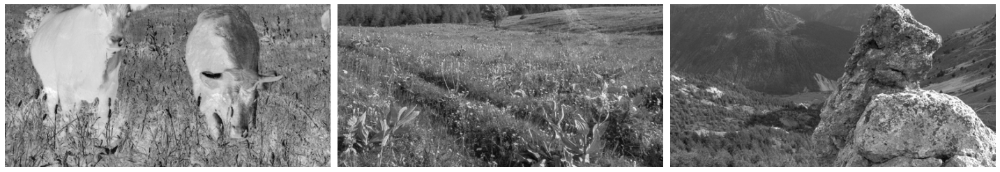

80001 322.58010697364807


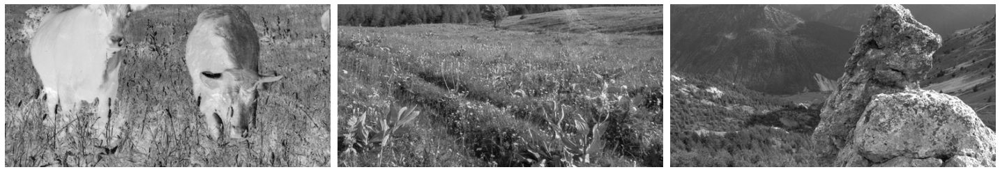

85001 341.1533989906311


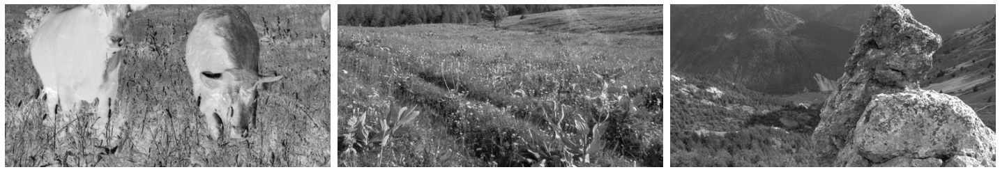

90001 359.3828818798065


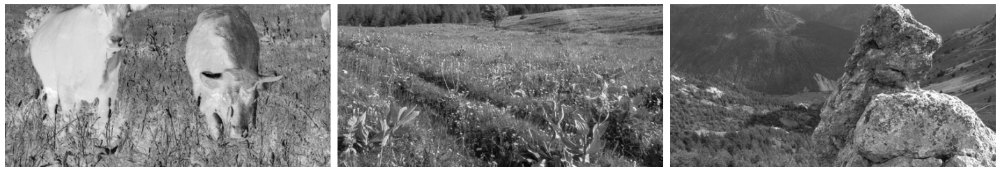

95001 381.51273703575134


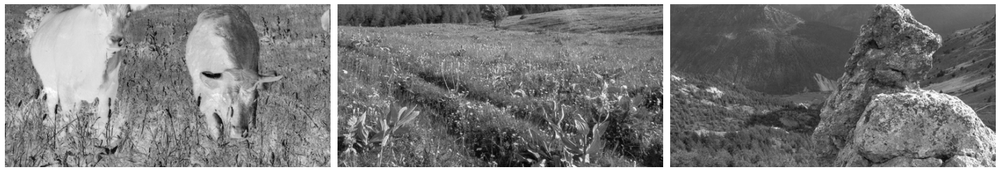

In [77]:
#all_indices_err=np.ceil(np.geomspace(1.0, 100000.0, num=50,endpoint=True))
all_indices_err=np.ceil(np.linspace(1.0, 100000.0, num=60,endpoint=True))

# Run offline Single-layer SM-ICA

X_SM=X #mixed sources

dim_Zmixed=X_SM.shape[0]
num_samples_test= X_SM.shape[1]

#print(dim_Zmixed)
#print(num_samples_test)

# Parameters initialization
size_input1=dim_Zmixed
size_output=dim_Zmixed


# initialization of W
W_off_SL=np.random.randn(size_output,size_input1)
# initialize M PSD
Gen_psd_M = np.random.randn(1000,size_output)
C = np.cov(Gen_psd_M.T)
M_off_SL =np.eye(size_output,size_output)

# Offline Training Single Layer
tic = time.time() 

Lambda_PCA=kurtosis(S, fisher=False)
eta=1*10**-4;
tau=2;

for iter in range(100000):
  
  # Neural dynamics
    C_SL=W_off_SL @ X_SM #projection/dendritic current 
    Y_SL= np.linalg.inv(M_off_SL) @ C_SL # lateral recurrent solution

  # used for the weight update of the second layer
    nonlin_alpha=sum(Y_SL*Y_SL)**1
    
  # Weights update 
    W_off_SL= W_off_SL + eta*( (1/num_samples_test)*Y_SL@X_SM.T - (1/num_samples_test)*nonlin_alpha*(np.diag(Lambda_PCA)@C_SL)@X_SM.T)
    M_off_SL= M_off_SL + (eta/tau)*( (1/num_samples_test)*Y_SL@Y_SL.T - np.eye(len(Lambda_PCA))) #

    if iter%(5*10**3)==1:
        
    
        toc = time.time() - tic
        print(iter, toc)
        
        figure = plt.figure(figsize=(20,10))
        for i in range(Y_SL.shape[0]):#s_dim
            plt.subplot(1,3,i+1)
            plt.imshow(-Y_SL[i].reshape(256,512), cmap="gray")
            plt.axis('off')

        figure.tight_layout(pad=0.5)
        plt.show()


In [78]:
num_samples_plot=50000
Y_SL_temp=Y_SL[:,0:num_samples_plot]
matrix_temp=X_SM[:,0:num_samples_plot]
all_x_temp=S.T[:,0:num_samples_plot]

Rescaled_Y=(((np.diag(1/(Y_SL_temp.max(axis=1)-Y_SL_temp.min(axis=1)) ))@( Y_SL_temp )).T)
Rescaled_matrix = (((np.diag(1/(matrix_temp.max(axis=1)-matrix_temp.min(axis=1) )))@( matrix_temp )).T)
Rescaled_sources = (((np.diag(1/(all_x_temp.max(axis=1)-all_x_temp.min(axis=1) )))@( all_x_temp )).T)

kurt_SM_ICA=np.zeros(Y_SL.shape[0])
kurt_mixtures=np.zeros(Y_SL.shape[0])
kurt_sources=np.zeros(Y_SL.shape[0])

for iter_rg in range(Y_SL.shape[0]):
    kurt_SM_ICA[iter_rg]= kurtosis(Rescaled_Y[:,iter_rg],fisher=True)
    kurt_mixtures[iter_rg]= kurtosis(Rescaled_matrix[:,iter_rg],fisher=True)
    kurt_sources[iter_rg]= kurtosis(Rescaled_sources[:,iter_rg],fisher=True)
    
arg_sort_SM_ICA = np.argsort(kurt_SM_ICA)
arg_sort_mixture = np.argsort(kurt_mixtures)
arg_sort_sources = np.argsort(kurt_sources)



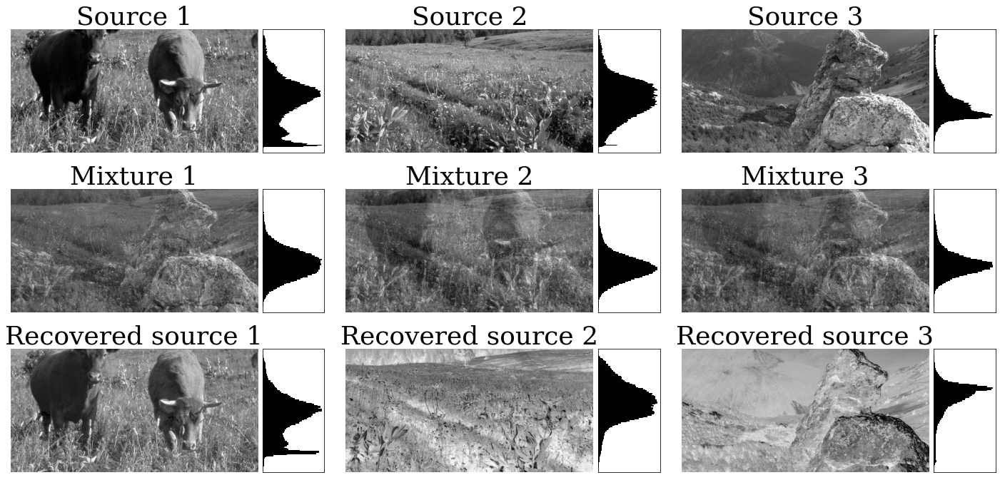

In [79]:
figure = plt.figure(figsize=(20,10))


font = {'family' : 'serif',
        'weight' : 'bold',
        'size'   :  30}

plt.rc('font',**font)#, family='serif'

for i in range(S.T.shape[0]):#s_dim
    ax=plt.subplot(3,3,i+1)
    plt.title('Source '+str(i+1))
    plt.imshow(S[:,arg_sort_sources[i]].reshape(256,512), cmap="gray")
    plt.axis('off')
    
    divider = make_axes_locatable(ax)
    axHisty = divider.append_axes("right", size=1.2, pad=0.1)
    axHisty.hist(S[:,arg_sort_sources[i]], bins=500,fc='k', ec='k', orientation='horizontal')#, range=(min_y_val, max_y_val),
    axHisty.grid(True)
    axHisty.get_xaxis().set_visible(False)
    axHisty.get_yaxis().set_visible(False)
    

for i in range(X_SM.shape[0]):#s_dim
    ax=plt.subplot(3,3,i+4)
    plt.imshow(X_SM[i].reshape(256,512), cmap="gray")
    plt.axis('off')
    plt.title('Mixture '+str(i+1))
    plt.imshow(X_SM[i].reshape(256,512), cmap="gray")
    plt.axis('off')
    
    divider = make_axes_locatable(ax)
    axHisty = divider.append_axes("right", size=1.2, pad=0.1)
    axHisty.hist(X_SM.T[:,arg_sort_mixture[i]], bins=100,fc='k', ec='k', orientation='horizontal')#, range=(min_y_val, max_y_val)
    axHisty.grid(True)
    axHisty.get_xaxis().set_visible(False)
    axHisty.get_yaxis().set_visible(False)


    
for i in range(Y_SL.shape[0]):#s_dim
    ax=plt.subplot(3,3,i+7)
    plt.imshow(Y_SL.T[:,arg_sort_SM_ICA[i]].reshape(256,512), cmap="gray")
    plt.axis('off')
    plt.title('Recovered source '+str(i+1))
    plt.axis('off')
    
    divider = make_axes_locatable(ax)
    axHisty = divider.append_axes("right", size=1.2, pad=0.1)
    axHisty.hist(Y_SL[arg_sort_SM_ICA[i],:], bins=100,fc='k', ec='k', orientation='horizontal')# range=(min_y_val, max_y_val)
    axHisty.grid(True)
    axHisty.get_xaxis().set_visible(False)
    axHisty.get_yaxis().set_visible(False)
    
figure.tight_layout(pad=1)
plt.show()



# Results shown in Supplement
## Online implementation and tests

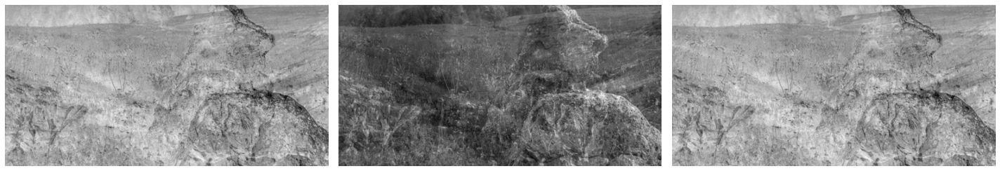

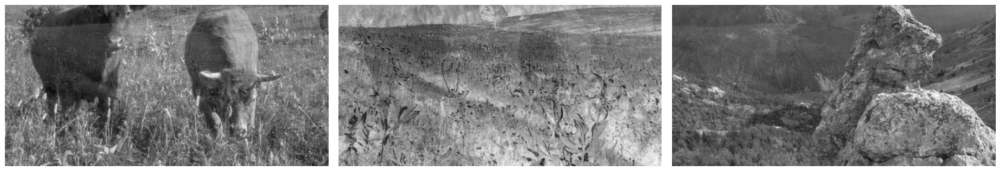

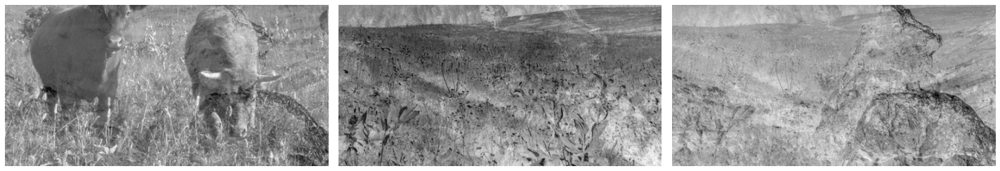

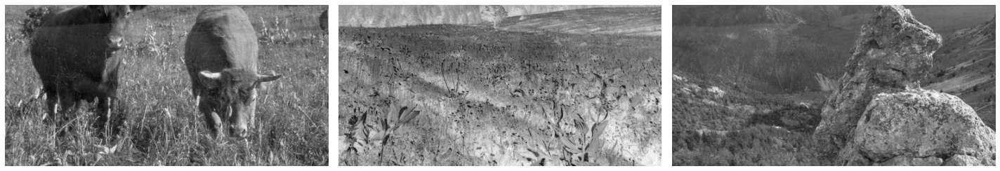

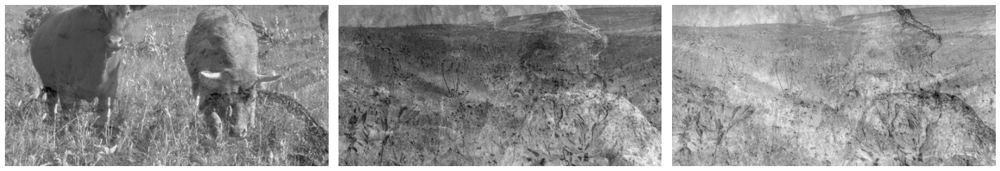

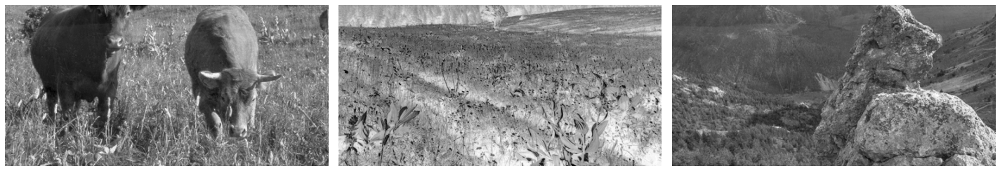

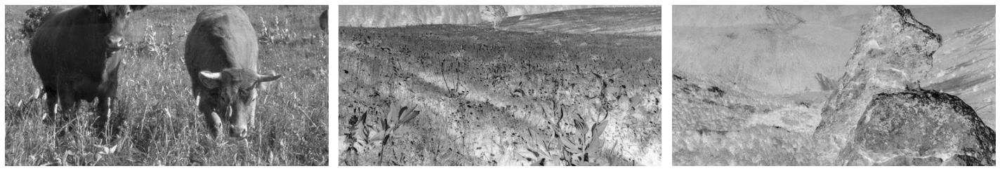

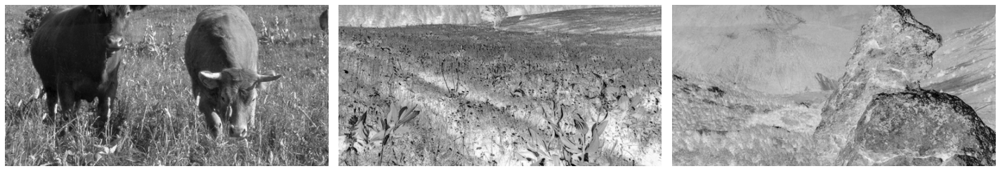

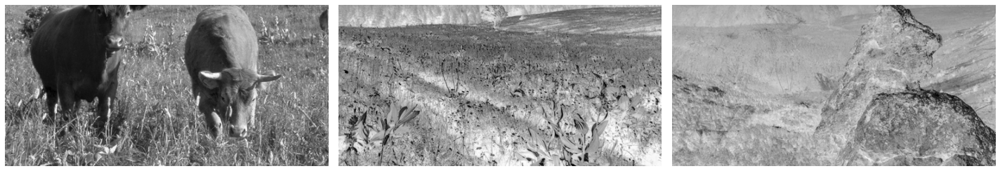

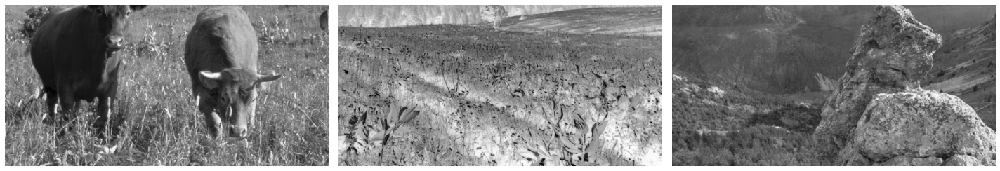

In [94]:
W_on_SL=np.random.randn(size_output,size_input1)

# initialize M PSD
Gen_psd_M = np.random.randn(1000,size_output)
C = np.cov(Gen_psd_M.T)
M_on_SL =np.eye(size_output,size_output)


Lambda_PCA=kurtosis(S, fisher=False)

for loop_data in range(50):
    
    
    Y_SL_off =np.linalg.inv(M_on_SL) @ W_on_SL @ X_SM

    # Show the results every 5 iterations through the whole dataset. 
    if loop_data%5==0:
        figure = plt.figure(figsize=(20,10))
        for i in range(Y_SL.shape[0]):
            plt.subplot(1,3,i+1)
            plt.imshow(Y_SL_off[i].reshape(256,512), cmap="gray")
            plt.axis('off')
        figure.tight_layout(pad=0.5)
        plt.show()
    
    #permutation of the data.
    new_idx= np.random.permutation(X_SM.shape[1])
    
    for iter in range(X_SM.shape[1]):

        x_SM=X_SM[:,new_idx[iter]]
        
        #projection
        C_SL=W_on_SL @ x_SM
        #neural dynamics
        y_SL_t= np.linalg.inv(M_on_SL) @ C_SL
        
        #global inhibitory factor
        nonlin_alpha=np.sum(y_SL_t**2)
        
        eta_t =2*10**-5
        tau=1.5
        #Synaptic weight updates
        W_on_SL= W_on_SL + 2*eta_t*( np.outer(y_SL_t,x_SM) - np.outer(nonlin_alpha*(np.diag(Lambda_PCA)@C_SL),x_SM))
        M_on_SL= M_on_SL + (eta_t/tau)*(np.outer(y_SL_t,y_SL_t) - np.eye(Lambda_PCA.shape[0]))        
    


In [95]:
#finding the order of the kurtosis to align with the true sources.

Y_SL_off =np.linalg.inv(M_on_SL) @ W_on_SL @ X_SM_temp

num_samples_plot=50000
Y_SL_temp_on=Y_SL_off[:,0:num_samples_plot]

Rescaled_Y_on=(((np.diag(1/(Y_SL_temp_on.max(axis=1)-Y_SL_temp_on.min(axis=1)) ))@( Y_SL_temp_on)).T)

kurt_SM_ICA_on=np.zeros(Y_SL_off.shape[0])

for iter_rg in range(Y_SL.shape[0]):
    kurt_SM_ICA_on[iter_rg]= kurtosis(Rescaled_Y_on[:,iter_rg],fisher=True)
    
arg_sort_SM_ICA_on = np.argsort(kurt_SM_ICA_on)



## Plot of the results obtained by our online ICA algorithm on Image separation tasks

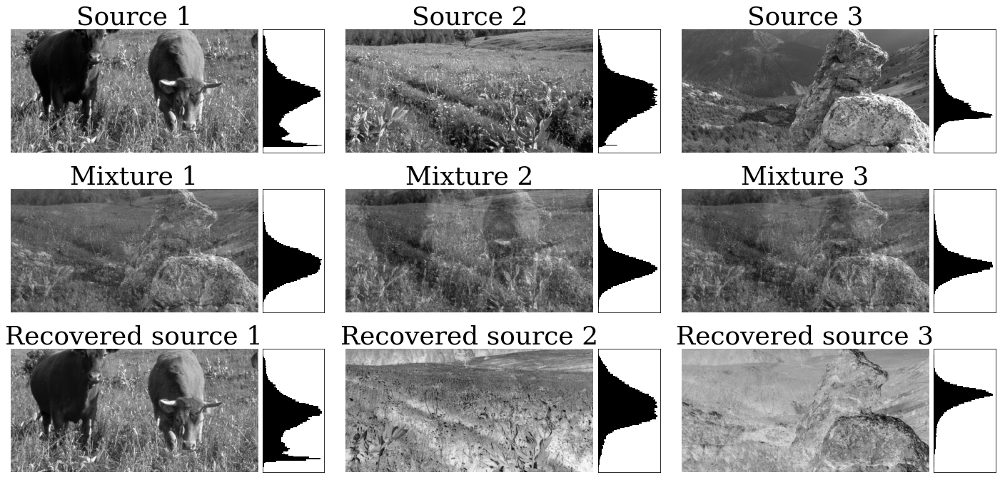

In [99]:
figure = plt.figure(figsize=(20,10))


font = {'family' : 'serif',
        'weight' : 'bold',
        'size'   :  30}

plt.rc('font',**font)#, family='serif'

for i in range(S.T.shape[0]):#s_dim
    ax=plt.subplot(3,3,i+1)
    plt.title('Source '+str(i+1))
    plt.imshow(S[:,arg_sort_sources[i]].reshape(256,512), cmap="gray")
    plt.axis('off')
    
    divider = make_axes_locatable(ax)
    axHisty = divider.append_axes("right", size=1.2, pad=0.1)
    axHisty.hist(S[:,arg_sort_sources[i]], bins=500,fc='k', ec='k', orientation='horizontal')#, range=(min_y_val, max_y_val),
    axHisty.grid(True)
    axHisty.get_xaxis().set_visible(False)
    axHisty.get_yaxis().set_visible(False)
    

for i in range(X_SM.shape[0]):#s_dim
    ax=plt.subplot(3,3,i+4)
    plt.imshow(X_SM[i].reshape(256,512), cmap="gray")
    plt.axis('off')
    plt.title('Mixture '+str(i+1))
    plt.imshow(X_SM[i].reshape(256,512), cmap="gray")
    plt.axis('off')
    
    divider = make_axes_locatable(ax)
    axHisty = divider.append_axes("right", size=1.2, pad=0.1)
    axHisty.hist(X_SM.T[:,arg_sort_mixture[i]], bins=100,fc='k', ec='k', orientation='horizontal')#, range=(min_y_val, max_y_val)
    axHisty.grid(True)
    axHisty.get_xaxis().set_visible(False)
    axHisty.get_yaxis().set_visible(False)


    
for i in range(Y_SL.shape[0]):#s_dim
    ax=plt.subplot(3,3,i+7)
    plt.imshow(Y_SL_off.T[:,arg_sort_SM_ICA_on[i]].reshape(256,512), cmap="gray")
    plt.axis('off')
    plt.title('Recovered source '+str(i+1))
    plt.axis('off')
    
    divider = make_axes_locatable(ax)
    axHisty = divider.append_axes("right", size=1.2, pad=0.1)
    axHisty.hist(Y_SL_off[arg_sort_SM_ICA_on[i],:], bins=100,fc='k', ec='k', orientation='horizontal')# range=(min_y_val, max_y_val)
    axHisty.grid(True)
    axHisty.get_xaxis().set_visible(False)
    axHisty.get_yaxis().set_visible(False)
    
figure.tight_layout(pad=1)
plt.show()

figure.savefig('fig_image_sep_online_v1.pdf')
